<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Description-des-dataset" data-toc-modified-id="Description-des-dataset-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Description des dataset</a></span></li><li><span><a href="#Nettoyage" data-toc-modified-id="Nettoyage-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Nettoyage</a></span><ul class="toc-item"><li><span><a href="#Duplicatas-et-valeurs-manquantes" data-toc-modified-id="Duplicatas-et-valeurs-manquantes-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Duplicatas et valeurs manquantes</a></span></li><li><span><a href="#Suppression-des-accents-des-noms-de-villes" data-toc-modified-id="Suppression-des-accents-des-noms-de-villes-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Suppression des accents des noms de villes</a></span></li><li><span><a href="#Mapping-des-catégories" data-toc-modified-id="Mapping-des-catégories-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Mapping des catégories</a></span></li><li><span><a href="#Merge-des-Dataframe" data-toc-modified-id="Merge-des-Dataframe-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Merge des Dataframe</a></span><ul class="toc-item"><li><span><a href="#Feature-engineering" data-toc-modified-id="Feature-engineering-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Feature engineering</a></span><ul class="toc-item"><li><span><a href="#Nombre-de-produits-par-commandes" data-toc-modified-id="Nombre-de-produits-par-commandes-2.4.1.1"><span class="toc-item-num">2.4.1.1&nbsp;&nbsp;</span>Nombre de produits par commandes</a></span></li><li><span><a href="#Nombre-de-produits-par-clients" data-toc-modified-id="Nombre-de-produits-par-clients-2.4.1.2"><span class="toc-item-num">2.4.1.2&nbsp;&nbsp;</span>Nombre de produits par clients</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#Analyse-exploratoire" data-toc-modified-id="Analyse-exploratoire-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Analyse exploratoire</a></span><ul class="toc-item"><li><span><a href="#Etude-de-la-Récence" data-toc-modified-id="Etude-de-la-Récence-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Etude de la Récence</a></span></li><li><span><a href="#Etude-de-la-fréquence-d'achat-des-clients" data-toc-modified-id="Etude-de-la-fréquence-d'achat-des-clients-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Etude de la fréquence d'achat des clients</a></span></li><li><span><a href="#Quel-est-le-montant-par-commandes?" data-toc-modified-id="Quel-est-le-montant-par-commandes?-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Quel est le montant par commandes?</a></span></li><li><span><a href="#Etude-de-la-satisfaction-client" data-toc-modified-id="Etude-de-la-satisfaction-client-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Etude de la satisfaction client</a></span></li><li><span><a href="#Quel-est-le-panier-moyen-par-commandes?" data-toc-modified-id="Quel-est-le-panier-moyen-par-commandes?-3.5"><span class="toc-item-num">3.5&nbsp;&nbsp;</span>Quel est le panier moyen par commandes?</a></span></li><li><span><a href="#Quel-est-la-catégorie-la-plus-vendue?" data-toc-modified-id="Quel-est-la-catégorie-la-plus-vendue?-3.6"><span class="toc-item-num">3.6&nbsp;&nbsp;</span>Quel est la catégorie la plus vendue?</a></span></li><li><span><a href="#Analyse-des-corrélations" data-toc-modified-id="Analyse-des-corrélations-3.7"><span class="toc-item-num">3.7&nbsp;&nbsp;</span>Analyse des corrélations</a></span></li></ul></li></ul></div>

In [1]:
import numpy as np
import pandas as pd
#import matplotlib as mpl
#%matplotlib inline
import matplotlib.pyplot as plt
import missingno as msno
import plotly
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
import plotly.express as px
import time 
#import scipy
#from scipy.stats import normaltest
import seaborn as sns
import sys


#%matplotlib inline

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', 100)

# Versions
print('Version des librairies utilisées :')

print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)
print('Python                : ' + sys.version)
print('Plotly                : ' + plotly.__version__)
#print('Matplotlib            : ' + mpl.__version__)
#print('Scipy                 : '+ scipy.__version__)
print('Seaborn               : ' + sns.__version__)
#print('Sklearn               : ' + sklearn.__version__)
#print('jyquickhelper         : ' + jyquickhelper.__version__)

Version des librairies utilisées :
NumPy                 : 1.20.3
Pandas                : 1.4.1
Python                : 3.9.7 (default, Sep 16 2021, 16:59:28) [MSC v.1916 64 bit (AMD64)]
Plotly                : 5.6.0
Seaborn               : 0.11.2


Note: you may need to restart the kernel to use updated packages.


ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'


## Description des dataset

**Objectif**: 
*  comprendre au maximum les données dont on dispose pour définir une stratégie de segmentation.

**Analyse de la forme** : 
    
   * **orders**: informations sur les commandes et leur métadonnées
     * **variable target** : order_id mais reste à identifier
     * **Nombre des lignes et de colonnes** : 99441, 8
     * **Types de variables** :8 qualitatives  
     * **Analyse des valeurs manquantes** : moins de 5 % uniquemment sur les dates de livraison et de depart de livraison et data de confirmation de commande
         * les types colonnes temporelles sont à corriger si on les garde. 
  
  ------------------------
   * **orders_item**: informations sur le contenu des commandes
     * **variable target** : order_id , customer_id, seller_id, 
     * **Nombre des lignes et de colonnes** : 112650, 7
     * **Types de variables** :4 qualitatives, 3 quantitatives  
     * **Analyse des valeurs manquantes** : aucune 
   ----------------------------- 
   
   * **order_review**: informations sur les commantaires des commandes
     * **variable target** : order_id, review_score	
     * **Nombre des lignes et de colonnes** : 99224, 7
     * **Types de variables** :6 qualitatives, 1 quantitatives  
     * **Analyse des valeurs manquantes** : 90% et 60% sur les commentaire et leur titre. 
         * mettre " " pour corriger 
     
  ---------------------------------  
   * **products**: informations sur les produits, nom, taille, photos
     * **variable target** : product_id, product_category_name	
     * **Nombre des lignes et de colonnes** : 32951, 9
     * **Types de variables** :7 qualitatives, 2 quantitatives  
     * **Analyse des valeurs manquantes** : environ 8 % sur les dimensions et la catégorie
     * 73 catégories différentes > Tenter de réduire ce nombre. 
         * A traduire avec le dataset category name
     ---------------------------- 
   * **payments**: informations sur les paiements, montant, echelonnés ou pas, payé avec bon d'achat ou non  
     * **variable target** : product_id, product_category_name	
     * **Nombre des lignes et de colonnes** : 103886, 5
     * **Types de variables** :2 qualitatives, 3 quantitatives  
     * **Analyse des valeurs manquantes** : aucune 
     
     ----------------------------------
   * **customer**: informations sur les clients, et leur origine
     * **variable target** : customer_unique_id, 	
     * **Nombre des lignes et de colonnes** : 99441, 5
     * **Types de variables** :4 qualitatives, 1 quantitatives  
     * **Analyse des valeurs manquantes** : 0 valeurs manquantes
     
     ----------------------------------
     
     
   * **sellers**: informations sur les vendeurs, localisation
     * **variable target** :  seller_id	
     * **Nombre des lignes et de colonnes** : 3095, 4
     * **Types de variables** : 3 qualitatives, 1 quantitatives  
     * **Analyse des valeurs manquantes** : 0 valeurs manquantes 
     
     ----------------------------------
   * **geolocation**: informations sur la localisation des code postaux et villes utilisés dans les autres dataset
     * **variable target** : zip code
     * **Nombre des lignes et de colonnes** : 1000163, 5
     * **Types de variables** :2 qualitatives, 3 quantitatives  
     * **Analyse des valeurs manquantes** : 0 valeurs manquantes 
     * 8011 villes différentes or selon internet
             https://cidades.ibge.gov.br/brasil/panoramail y en a 5570 , des corrections a faire au niveau de accents et enventuellement traduction. 
    ----------------------------------
         
   * **category_name**: traduction en anglais des noms de produits
     * **variable target** :  product name	
     * **Nombre des lignes et de colonnes** : 71, 2
     * **Types de variables** :2 qualitatives 
     * **Analyse des valeurs manquantes** : 0 valeurs manquantes  

# **Analyse de fond**

     

In [2]:
#chargement des données 
orders = pd.read_csv("olist_orders_dataset.csv")

order_item = pd.read_csv("olist_order_items_dataset.csv")

order_review = pd.read_csv("olist_order_reviews_dataset.csv")

products = pd.read_csv("olist_products_dataset.csv")

payments = pd.read_csv("olist_order_payments_dataset.csv")

customer = pd.read_csv("olist_customers_dataset.csv")

sellers = pd.read_csv("olist_sellers_dataset.csv")

geolocation = pd.read_csv("olist_geolocation_dataset.csv")

category_name = pd.read_csv("product_category_name_translation.csv")

In [3]:
def description_dataset(data, matrix):
    '''
    Return the description of a dataset
    
        Parameters: 
            data: dataframe
            matrix(bool): indicates if we plot the msno matrix of data
            
        Returns:
            the 3 first line of the dataframe
            the shape, the types, th number of null values,
            the number of unique values, the number of duplicated values
            
    '''
    if matrix == True:
        msno.matrix(data)
        
    display(data.head(3))
    print(f'Taille :-------------------------------------------------------------- {data.shape}')
    print("--"*50)
    print(f'Types :{data.dtypes.value_counts()}')
    print("--"*50)
    print(f'Types :{data.dtypes}')
    print("--"*50)
    print("Valeurs manquantes par colonnes (%): ")
    print((((data.isna().sum()/data.shape[0])*100).round(2)).sort_values(ascending= False))
    print("--"*50)
    print("Valeurs différentes par variables : ")
    for col in data:
        if data[col].nunique() < 30:
            print (f'{col :-<70} {data[col].unique()}')
        else : 
            print(f'{col :-<70} contient {data[col].nunique()} valeurs différentes')
    print("--"*50)
    print(f"Nombre de doublons : {data.duplicated().sum()}")


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00


Taille :-------------------------------------------------------------- (99441, 8)
----------------------------------------------------------------------------------------------------
Types :object    8
dtype: int64
----------------------------------------------------------------------------------------------------
Types :order_id                         object
customer_id                      object
order_status                     object
order_purchase_timestamp         object
order_approved_at                object
order_delivered_carrier_date     object
order_delivered_customer_date    object
order_estimated_delivery_date    object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
order_delivered_customer_date    2.98
order_delivered_carrier_date     1.79
order_approved_at                0.16
order_id                         0.00
customer_id                      0.00
order_status  

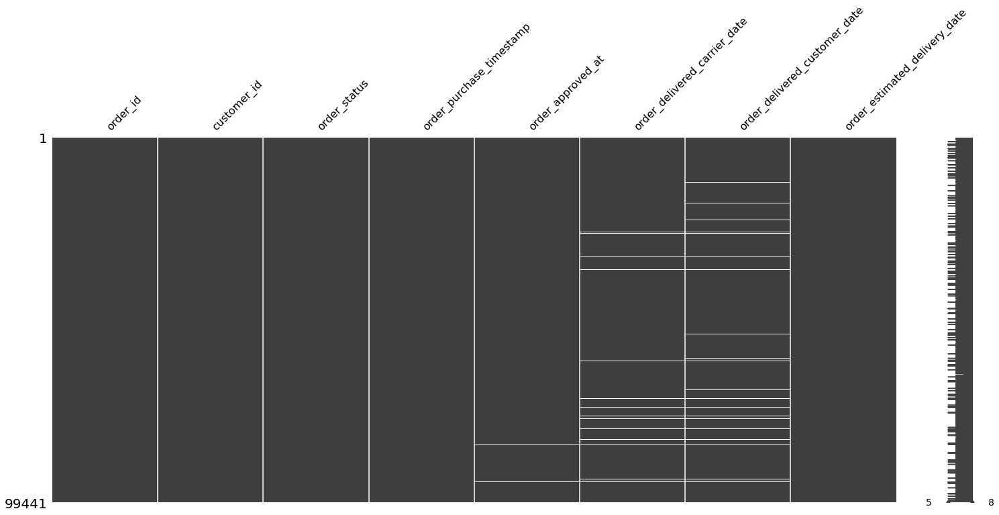

In [4]:
description_dataset(orders, matrix = True)

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.9,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.9,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.0,17.87


Taille :-------------------------------------------------------------- (112650, 7)
----------------------------------------------------------------------------------------------------
Types :object     4
float64    2
int64      1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :order_id                object
order_item_id            int64
product_id              object
seller_id               object
shipping_limit_date     object
price                  float64
freight_value          float64
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
order_id               0.0
order_item_id          0.0
product_id             0.0
seller_id              0.0
shipping_limit_date    0.0
price                  0.0
freight_value          0.0
dtype: float64
---------------------------------------------------------------------------

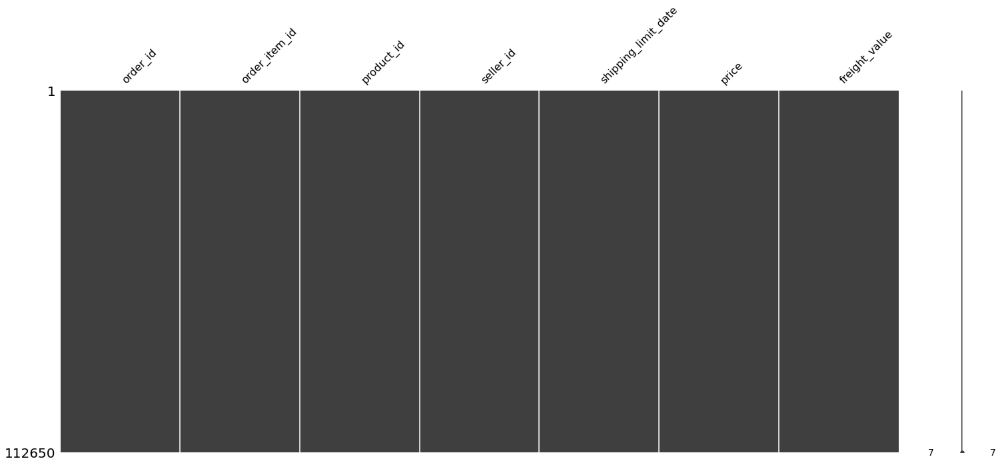

In [5]:
description_dataset(order_item, matrix=True)

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0


Taille :-------------------------------------------------------------- (32951, 9)
----------------------------------------------------------------------------------------------------
Types :float64    7
object     2
dtype: int64
----------------------------------------------------------------------------------------------------
Types :product_id                     object
product_category_name          object
product_name_lenght           float64
product_description_lenght    float64
product_photos_qty            float64
product_weight_g              float64
product_length_cm             float64
product_height_cm             float64
product_width_cm              float64
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
product_category_name         1.85
product_name_lenght           1.85
product_description_lenght    1.85
product_photos_qty            1.85
product_weight_g            

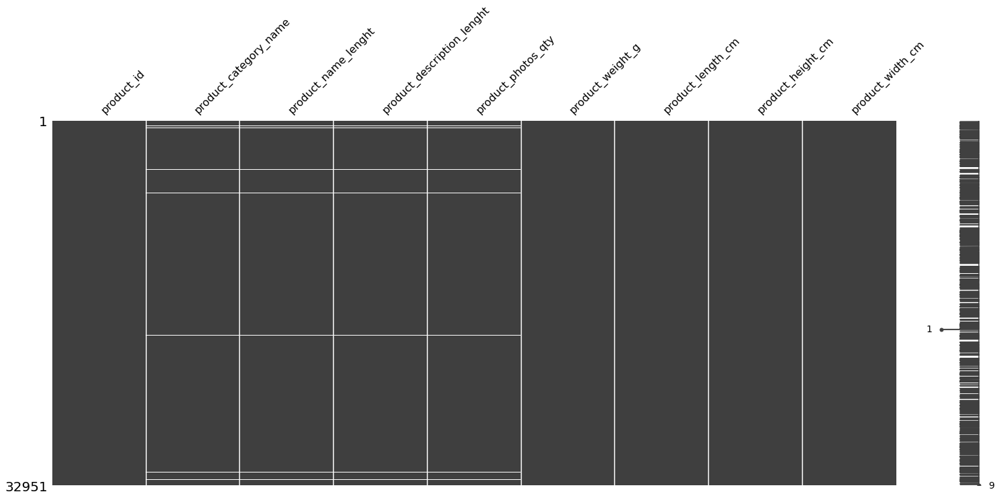

In [6]:
description_dataset(products,matrix = True)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71


Taille :-------------------------------------------------------------- (103886, 5)
----------------------------------------------------------------------------------------------------
Types :object     2
int64      2
float64    1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :order_id                 object
payment_sequential        int64
payment_type             object
payment_installments      int64
payment_value           float64
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
order_id                0.0
payment_sequential      0.0
payment_type            0.0
payment_installments    0.0
payment_value           0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Valeurs différentes par variables : 
order_id-----------------------------------

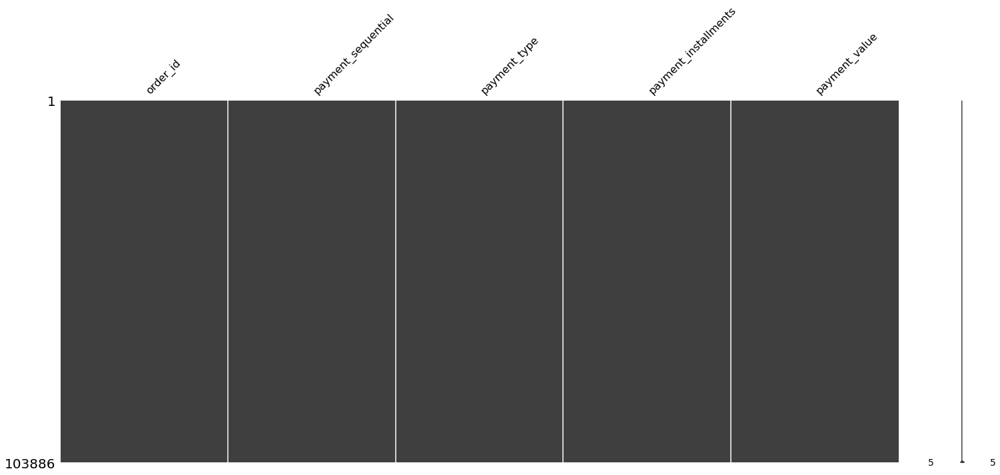

In [7]:
description_dataset(payments,matrix = True)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24


Taille :-------------------------------------------------------------- (99224, 7)
----------------------------------------------------------------------------------------------------
Types :object    6
int64     1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :review_id                  object
order_id                   object
review_score                int64
review_comment_title       object
review_comment_message     object
review_creation_date       object
review_answer_timestamp    object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
review_comment_title       88.34
review_comment_message     58.70
review_id                   0.00
order_id                    0.00
review_score                0.00
review_creation_date        0.00
review_answer_timestamp     0.00
dtype: float64
----------------------------

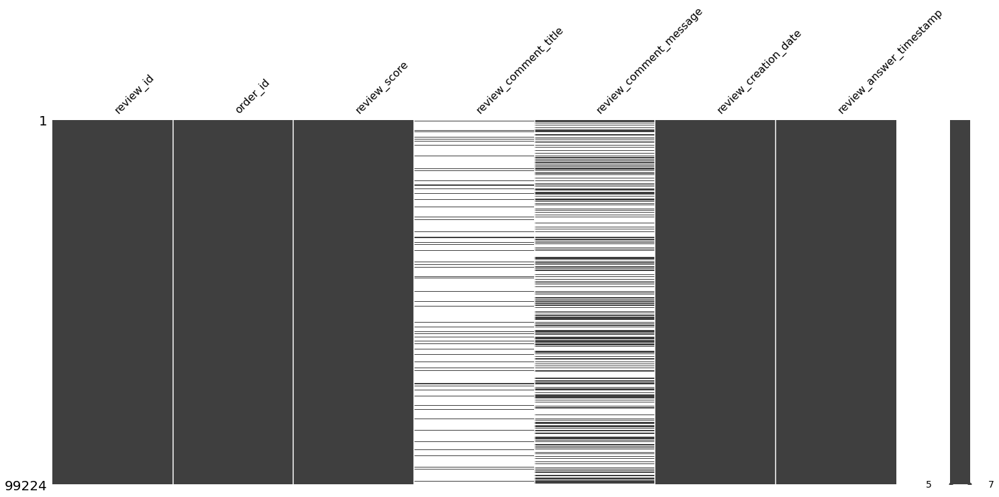

In [8]:
description_dataset(order_review, matrix= True)

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP


Taille :-------------------------------------------------------------- (99441, 5)
----------------------------------------------------------------------------------------------------
Types :object    4
int64     1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :customer_id                 object
customer_unique_id          object
customer_zip_code_prefix     int64
customer_city               object
customer_state              object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
customer_id                 0.0
customer_unique_id          0.0
customer_zip_code_prefix    0.0
customer_city               0.0
customer_state              0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Valeurs différentes par variables : 
customer_id-------------

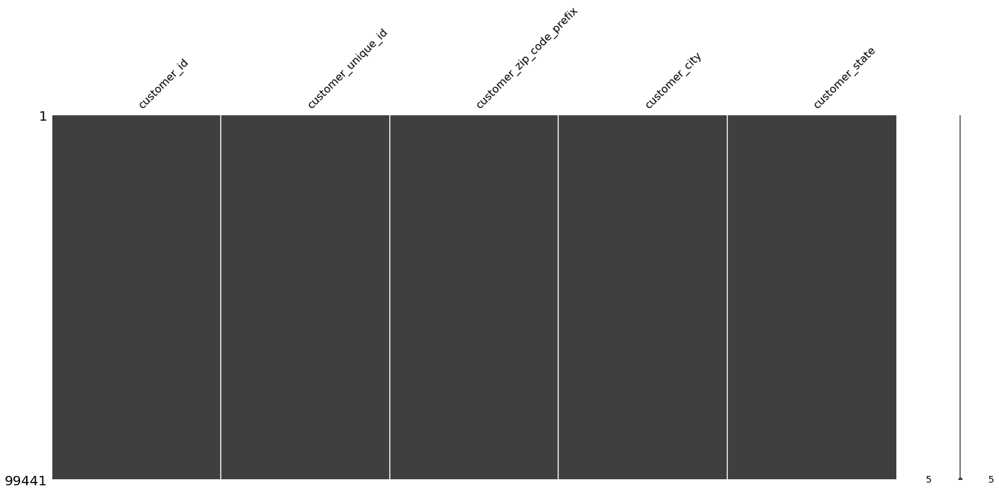

In [9]:
description_dataset(customer, matrix = True)

In [10]:
df_cus = customer.groupby(['customer_unique_id']).count()
df_cus.customer_id.value_counts()

1     93099
2      2745
3       203
4        30
5         8
6         6
7         3
9         1
17        1
Name: customer_id, dtype: int64

Un client est identifié grâce un identifiant unique, mais à chaque commande il a un identifiant de client qui se crée. 
Nous allons devoir traiter cette information. 

In [11]:
df_cus.loc[ "b6c083700ca8c135ba9f0f132930d4e8"]

customer_id                 2
customer_zip_code_prefix    2
customer_city               2
customer_state              2
Name: b6c083700ca8c135ba9f0f132930d4e8, dtype: int64

In [12]:
description_dataset(sellers, matrix = False)

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ


Taille :-------------------------------------------------------------- (3095, 4)
----------------------------------------------------------------------------------------------------
Types :object    3
int64     1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :seller_id                 object
seller_zip_code_prefix     int64
seller_city               object
seller_state              object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
seller_id                 0.0
seller_zip_code_prefix    0.0
seller_city               0.0
seller_state              0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Valeurs différentes par variables : 
seller_id------------------------------------------------------------- contient 3095 valeurs différentes
sel

In [13]:
description_dataset(geolocation,matrix = False)

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP


Taille :-------------------------------------------------------------- (1000163, 5)
----------------------------------------------------------------------------------------------------
Types :float64    2
object     2
int64      1
dtype: int64
----------------------------------------------------------------------------------------------------
Types :geolocation_zip_code_prefix      int64
geolocation_lat                float64
geolocation_lng                float64
geolocation_city                object
geolocation_state               object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
geolocation_zip_code_prefix    0.0
geolocation_lat                0.0
geolocation_lng                0.0
geolocation_city               0.0
geolocation_state              0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Valeurs d

In [14]:
description_dataset(category_name,matrix = False)

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto


Taille :-------------------------------------------------------------- (71, 2)
----------------------------------------------------------------------------------------------------
Types :object    2
dtype: int64
----------------------------------------------------------------------------------------------------
Types :product_category_name            object
product_category_name_english    object
dtype: object
----------------------------------------------------------------------------------------------------
Valeurs manquantes par colonnes (%): 
product_category_name            0.0
product_category_name_english    0.0
dtype: float64
----------------------------------------------------------------------------------------------------
Valeurs différentes par variables : 
product_category_name------------------------------------------------- contient 71 valeurs différentes
product_category_name_english----------------------------------------- contient 71 valeurs différentes
--------------

Aucun de nos dataset n'a de valeurs en double sauf celui de geolocation. 

## Nettoyage

### Duplicatas et valeurs manquantes

In [15]:
#Duplicatas
geolocation.drop_duplicates(inplace = True)

# Valeurs manquantes, on traite les variables succeptibles d'être utilisées
products.product_category_name.fillna("unknown", inplace = True)

order_review.fillna(" ", inplace= True)

orders['order_approved_at'].fillna(0, inplace=True) 
orders['order_delivered_carrier_date'].fillna(0, inplace=True)
orders['order_delivered_customer_date'].fillna(0, inplace=True)

### Suppression des accents des noms de villes 

In [16]:
import unicodedata
def timeit(f):

    def timed(*args, **kw):

        ts = time.time()
        result = f(*args, **kw)
        te = time.time()

        print (f"Durée d'exécution de {f.__name__}: {te-ts}s")
        return result

    return timed


def strip_accents(text):
    """
    Strip accents from input String.

        param text: The input string.
        type text: String.

    returns: The processed String.
    rtype: String.
    """
    try:
        text = unicode(text, 'utf-8')
    except (TypeError, NameError): # unicode is a default on python 3 
        pass
    text = unicodedata.normalize('NFKD', text)
    text = text.encode('ascii', 'ignore')
    text = text.decode("utf-8")
    return str(text)

In [17]:
geolocation.geolocation_city = geolocation.geolocation_city.apply(lambda x: strip_accents(x))

In [18]:
geolocation.geolocation_city.nunique()

5968

### Mapping des catégories

In [19]:
#Nettoyage avant traduction des catégories de produits 
print("Il manque ces catégories dans la traduction en anglais : ",
      set(products.product_category_name)- set(category_name.product_category_name))

t = len(category_name)

category_name.loc[t,'product_category_name'] = 'unknown'
category_name.loc[t,'product_category_name_english'] = 'unknown'

category_name.loc[t+1,'product_category_name'] = 'pc_gamer'
category_name.loc[t+1,'product_category_name_english'] = 'pc_gamer'

category_name.loc[t+2,'product_category_name'] = 'portateis_cozinha_e_preparadores_de_alimentos'
category_name.loc[t+2,'product_category_name_english'] = 'small_appliances_kitchen_and_food_processors'

products_en = pd.merge(category_name,products, on =["product_category_name"])

Il manque ces catégories dans la traduction en anglais :  {'portateis_cozinha_e_preparadores_de_alimentos', 'unknown', 'pc_gamer'}


In [20]:
categories = {
    #appliances : electroménager
    'home_appliances' :'appliances',
    'home_appliances_2' : 'appliances',
    'small_appliances_kitchen_and_food_processors' : 'appliances',
    'small_appliances_home_oven_and_coffee' : 'appliances',
    'small_appliances': 'appliances',
    'air_conditioning' : 'appliances',
    
    #tools : outils
    'garden_tools': 'tools',
    'costruction_tools_garden' : 'tools',
    'home_construction' : 'tools',
    'costruction_tools_tools' : 'tools',
    'construction_tools_lights' : 'tools',
    'construction_tools_construction' : 'tools', 
    'construction_tools_safety' : 'tools', 
    
    #electronique
    'electronics' : 'electronics',
    'computers_accessories': 'electronics',
    'telephony' : 'electronics',
    'consoles_games' : 'electronics',
    'computers' : 'electronics',
    'pc_gamer' : 'electronics',
    'fixed_telephony' : 'electronics',
    'tablets_printing_image' : 'electronics',
    
    #hygiene et beauté
    'health_beauty' : 'hygiene_and_beauty',
    'perfumery' : 'hygiene_and_beauty',
    'diapers_and_hygiene': 'hygiene_and_beauty', 
  
    #loisirs et auto
    'sports_leisure' : 'auto_leisure', 
    'toys': 'auto_leisure',
     'auto': 'auto_leisure',
    
    #fashion
    'watches_gifts' : 'fashion',  
    'fashion_bags_accessories' : 'fashion',
    'fashion_shoes': 'fashion',
    'fashion_male_clothing' : 'fashion',
    'fashio_female_clothing' : 'fashion',
    'fashion_childrens_clothes' : 'fashion',
    'fashion_underwear_beach' : 'fashion',
    'fashion_sport' : 'fashion',
    'baby' : 'fashion',
    'luggage_accessories' : 'fashion', 
     
    #mobilier
    'kitchen_dining_laundry_garden_furniture' : 'furniture',
    'furniture_living_room' : 'furniture', 
    'furniture_mattress_and_upholstery' : 'furniture',
    'office_furniture' : 'furniture',
    'furniture_bedroom' : 'furniture',
    
    #articles de décoration
    'furniture_decor': 'decoration' ,
    'christmas_supplies': 'decoration',
    'party_supplies': 'decoration',
    'bed_bath_table' : 'decoration',
   
    #articles ménagers
    'housewares': 'housewares',
    'home_confort' : 'housewares',
    'home_comfort_2' : 'housewares',
    'la_cuisine': 'housewares',
    'stationery': 'housewares',
       
    #jardin et extérieurs
    'pet_shop': 'garden_outdoors',
    'flowers': 'garden_outdoors', 
    'signaling_and_security' : 'garden_outdoors' ,
    #services
    'market_place' : 'service',   
    'industry_commerce_and_business' : 'services',
    'security_and_services' : 'services', 
    
    #culture 
    'arts_and_craftmanship' : 'culture',   
    'books_technical': 'culture',
    'books_general_interest': 'culture',
    'books_imported': 'culture',
    'musical_instruments' : 'culture',
    'cds_dvds_musicals' : 'culture',
    'dvds_blu_ray' : 'culture',
    'cine_photo' : 'culture',
    'audio' : 'culture',
    'music' : 'culture',
    'art' : 'culture', 
    
    #aliments et boissons
    'food': 'food_drinks',
    'food_drink' : 'food_drinks',
    'drinks': 'food_drinks',
    'agro_industry_and_commerce' : 'food_drinks',
    
    #autres
    'cool_stuff': "other",
    'unknown' : "other", 
}

In [21]:
products_en['product_category_name'] = products_en['product_category_name_english'].astype('object')
products_en['product_category_name'] = products_en ['product_category_name_english'].replace(categories, regex=False)

### Merge des Dataframe

In [22]:
df= pd.merge(orders, customer,
             how= 'left',
             on= ['customer_id']).merge(payments,
                how='left',
                on='order_id').merge(order_item,
                how='left',
                on='order_id').merge(products_en,
                how='left',
                on='product_id').merge(sellers,
                how='left',
                on='seller_id').merge(order_review,
                how='left',
                on = 'order_id')

-------------------------------------
Il faut convertir au format date les colonnes en contenant. 


In [23]:
date_cols = ['order_purchase_timestamp',
    'order_approved_at',
    'order_delivered_carrier_date',
    'order_delivered_customer_date',
    'order_estimated_delivery_date']


df[date_cols] = df[date_cols].apply(pd.to_datetime)

-------------------------------
On ne garde que les commandes livrées

In [24]:
df.order_status.value_counts()

delivered      115723
shipped          1256
canceled          750
unavailable       652
invoiced          378
processing        376
created             5
approved            3
Name: order_status, dtype: int64

In [25]:
df = df[df.order_status == 'delivered']

In [26]:
print("Date du dernier achat", df.order_purchase_timestamp.max())
print("Date du premier achat", df.order_purchase_timestamp.min())

Date du dernier achat 2018-08-29 15:00:37
Date du premier achat 2016-09-15 12:16:38


In [27]:
last_order = df.order_purchase_timestamp.max()

df['days_since_last_order'] = (last_order - df.order_purchase_timestamp).astype('timedelta64[D]')

#### Feature engineering 

##### Nombre de produits par commandes

In [28]:
quantity_order = df.groupby(['order_id','product_id']).size().reset_index(name='order_item_quantity')

In [29]:
df = pd.merge(quantity_order,df,how = 'left',  on=['order_id', 'product_id']).drop_duplicates().reset_index(drop=True)


In [30]:
df = df.drop(axis = 1, columns = "order_item_id")

In [31]:
df

,order_id,product_id,order_item_quantity,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,days_since_last_order
0,00010242fe8c5a6d1ba2dd792cb16214,4244733e06e7ecb4970a6e2683c13e61,1,3ce436f183e68e07877b285a838db11a,delivered,2017-09-13 08:59:02,2017-09-13 09:45:35,2017-09-19 18:34:16,2017-09-20 23:43:48,2017-09-29,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,1.0,credit_card,2.0,72.19,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,other,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0,27277.0,volta redonda,SP,97ca439bc427b48bc1cd7177abe71365,5.0,,"Perfeito, produto entregue antes do combinado.",2017-09-21 00:00:00,2017-09-22 10:57:03,350.0
1,00018f77f2f0320c557190d7a144bdd3,e5f2d52b802189ee658865ca93d83a8f,1,f6dd3ec061db4e3987629fe6b26e5cce,delivered,2017-04-26 10:53:06,2017-04-26 11:05:13,2017-05-04 14:35:00,2017-05-12 16:04:24,2017-05-15,eb28e67c4c0b83846050ddfb8a35d051,15775,santa fe do sul,SP,1.0,credit_card,3.0,259.83,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,garden_outdoors,pet_shop,56.0,239.0,2.0,30000.0,50.0,30.0,40.0,3471.0,sao paulo,SP,7b07bacd811c4117b742569b04ce3580,4.0,,,2017-05-13 00:00:00,2017-05-15 11:34:13,490.0
2,000229ec398224ef6ca0657da4fc703e,c777355d18b72b67abbeef9df44fd0fd,1,6489ae5e4333f3693df5ad4372dab6d3,delivered,2018-01-14 14:33:31,2018-01-14 14:48:30,2018-01-16 12:36:48,2018-01-22 13:19:16,2018-02-05,3818d81c6709e39d06b2738a8d3a2474,35661,para de minas,MG,1.0,credit_card,5.0,216.87,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,decoration,furniture_decor,59.0,695.0,2.0,3050.0,33.0,13.0,33.0,37564.0,borda da mata,MG,0c5b33dea94867d1ac402749e5438e8b,5.0,,Chegou antes do prazo previsto e o produto sur...,2018-01-23 00:00:00,2018-01-23 16:06:31,227.0
3,00024acbcdf0a6daa1e931b038114c75,7634da152a4610f1595efa32f14722fc,1,d4eb9395c8c0431ee92fce09860c5a06,delivered,2018-08-08 10:00:35,2018-08-08 10:10:18,2018-08-10 13:28:00,2018-08-14 13:32:39,2018-08-20,af861d436cfc08b2c2ddefd0ba074622,12952,atibaia,SP,1.0,credit_card,2.0,25.78,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,hygiene_and_beauty,perfumery,42.0,480.0,1.0,200.0,16.0,10.0,15.0,14403.0,franca,SP,f4028d019cb58564807486a6aaf33817,4.0,,,2018-08-15 00:00:00,2018-08-15 16:39:01,21.0
4,00042b26cf59d7ce69dfabb4e55b4fd9,ac6c3623068f30de03045865e4e10089,1,58dbd0b2d70206bf40e62cd34e84d795,delivered,2017-02-04 13:57:51,2017-02-04 14:10:13,2017-02-16 09:46:09,2017-03-01 16:42:31,2017-03-17,64b576fb70d441e8f1b2d7d446e483c5,13226,varzea paulista,SP,1.0,credit_card,3.0,218.04,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,tools,garden_tools,59.0,409.0,1.0,3750.0,35.0,40.0,30.0,87900.0,loanda,PR,940144190dcba6351888cafa43f3a3a5,5.0,,Gostei pois veio no prazo determinado .,2017-03-02 00:00:00,2017-03-03 10:54:59,571.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115718,fffc94f6ce00a00581880bf54a75a037,4aa6014eceb682077f9dc4bffebc05b0,1,b51593916b4b8e0d6f66f2ae24f2673d,delivered,2018-04-23 13:57:06,2018-04-25 04:11:01,2018-04-25 12:09:00,2018-05-10 22:56:40,2018-05-18,0c9aeda10a71f369396d0c04dce13a64,65077,sao luis,MA,1.0,boleto,1.0,343.40,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99

##### Nombre de produits par clients


In [32]:
quantity_per_customer = df.groupby(['customer_id'])['product_id'].count().reset_index(name= 'tot_product')

In [33]:
df = pd.merge(quantity_per_customer, df,how = 'left', on=['customer_id']).drop_duplicates().reset_index(drop=True)

In [34]:
df.tot_product.equals(df.order_item_quantity)

False

In [35]:
paie = df.sort_values(['customer_id','payment_type','payment_installments'],ascending=False).groupby(
        ['customer_id', 'payment_type','payment_installments']).head(1)[[
        'customer_id', 'payment_type','payment_installments']]
paie.rename(columns = {'payment_type' : 'prefered_payment',
           'payment_installments' : 'most_frequent_number_of_payments'}, inplace= True)

In [36]:
paie

,customer_id,prefered_payment,most_frequent_number_of_payments
105306,ffffa3172527f765de70084a7e53aae8,credit_card,4.0
105305,ffff42319e9b2d713724ae527742af25,credit_card,2.0
105304,fffeda5b6d849fbd39689bb92087f431,credit_card,3.0
105302,fffecc9f79fd8c764f843e9951b11341,voucher,1.0
105301,fffecc9f79fd8c764f843e9951b11341,credit_card,1.0
...,...,...,...
4,000379cdec625522490c315e70c7a9fb,boleto,1.0
3,0002414f95344307404f0ace7a26f1d5,boleto,1.0
2,0001fd6190edaaf884bcaf3d49edf079,credit_card,10.0
1,000161a058600d5901f007fab4c27140,credit_card,5.0


In [37]:
df= pd.merge(paie, df, how = 'left', on =['customer_id']).drop_duplicates().reset_index(drop=True)

In [38]:
df

,customer_id,prefered_payment,most_frequent_number_of_payments,tot_product,order_id,product_id,order_item_quantity,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_category_name_english,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,days_since_last_order
0,ffffa3172527f765de70084a7e53aae8,credit_card,4.0,2,d0e7be325a1c986babc4e1cdb91edc03,43ee88561093499d9e571d4db5f20b79,2,delivered,2017-09-02 11:53:32,2017-09-02 12:05:40,2017-09-08 20:04:11,2017-09-14 19:47:40,2017-09-26,48fd7dec70f2b104a1d5e8c5c639102b,37130,alfenas,MG,1.0,credit_card,4.0,45.50,23613d49c3ac2bd302259e55c06c050c,2017-09-08 12:05:40,10.90,11.85,decoration,furniture_decor,39.0,161.0,3.0,200.0,20.0,20.0,20.0,13660.0,porto ferreira,SP,6f5fbcdcdf749cd3fc52d7ee2254dccc,5.0,,,2017-09-15 00:00:00,2017-09-16 00:57:27,361.0
1,ffff42319e9b2d713724ae527742af25,credit_card,2.0,1,83b5fc912b2862c5046555ded1483ae9,e61c78a7343d82c0539d27df0f7dfc31,1,delivered,2018-06-13 16:57:05,2018-06-13 17:20:23,2018-06-15 18:52:00,2018-06-18 18:33:05,2018-06-25,680213db6ebd9e4f24d03280cbe10346,6754,taboao da serra,SP,1.0,credit_card,2.0,214.13,da8622b14eb17ae2831f4ac5b9dab84a,2018-06-15 17:20:23,199.90,14.23,decoration,bed_bath_table,60.0,268.0,1.0,2700.0,41.0,8.0,36.0,13405.0,piracicaba,SP,b352955008d37f0c2a659bef5f8b14c8,5.0,Ótimo,Um produto de boa qualidade e entraga no prazo,2018-06-19 00:00:00,2018-06-19 21:55:15,76.0
2,fffeda5b6d849fbd39689bb92087f431,credit_card,3.0,1,8c855550908247a7eff50281b92167a8,d5c263f4d651ba657c900ce70a4be7de,1,delivered,2018-05-22 13:36:02,2018-05-22 13:54:37,2018-05-25 13:25:00,2018-06-08 18:03:31,2018-06-29,afbb5a642107cf6bb1ca68e863175f03,22461,rio de janeiro,RJ,1.0,credit_card,3.0,63.13,dd55f1bb788714a40e7954c3be6df745,2018-05-28 13:54:37,47.90,15.23,electronics,telephony,59.0,458.0,4.0,350.0,20.0,30.0,20.0,1021.0,sao paulo,SP,097a61fc86e765d26a1d13315c76482b,4.0,,,2018-06-09 00:00:00,2018-06-13 18:34:25,99.0
3,fffecc9f79fd8c764f843e9951b11341,voucher,1.0,3,814d6a3a7c0b32b2ad929ac6328124e9,c045b19fdb30a3035c56d04c6fe2e622,3,delivered,2018-03-29 16:59:26,2018-03-29 17:10:27,2018-03-31 14:29:38,2018-04-10 17:20:49,2018-04-27,e5794df8573fa179a90a7b797fc4b71f,95630,parobe,RS,1.0,credit_card,1.0,0.64,259f7b5e6e482c230e5bfaa670b6bb8f,2018-04-04 17:10:27,54.90,26.46,decoration,bed_bath_table,48.0,641.0,3.0,2050.0,50.0,10.0,40.0,8550.0,poa,SP,1252f94367f5f2497f2d62927bf24549,3.0,,,2018-04-11 00:00:00,2018-04-14 16:25:21,152.0
4,fffecc9f79fd8c764f843e9951b11341,voucher,1.0,3,814d6a3a7c0b32b2ad929ac6328124e9,c045b19fdb30a3035c56d04c6fe2e622,3,delivered,2018-03-29 16:59:26,2018-03-29 17:10:27,2018-03-31 14:29:38,2018-04-10 17:20:49,2018-04-27,e5794df8573fa179a90a7b797fc4b71f,95630,parobe,RS,3.0,voucher,1.0,9.49,259f7b5e6e482c230e5bfaa670b6bb8f,2018-04-04 17:10:27,54.90,26.46,decoration,bed_bath_table,48.0,641.0,3.0,2050.0,50.0,10.0,40.0,8550.0,poa,SP,1252f94367f5f2497f2d62927bf24549,3.0,,,2018-04-11 00:00:00,2018-04-14 16:25:21,152.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111092,000379cdec625522490c315e70c7a9fb,boleto,1.0,1,0ab7fb08086d4af9141453c91878ed7a,868b3136c5b206f91b8208fbfdf2cb7c,1,delivered,2018-04-02 13:42:17,2018-04-04 03:10:19,2018-04-04 18:11:09,2018-04-13 20:21:08,2018-04-18,0b83f73b19c2019e182fd552c048a22c,4841,sao paulo,SP,1.0,boleto,1.0,107.01,4a3ca9315b7

In [39]:
dict_agg = {"order_id": "nunique",
            'order_purchase_timestamp' : 'max',
            'days_since_last_order' : 'min',
            'customer_state' : lambda x: x.mode(),
            'prefered_payment' : lambda x: x.mode()[0],
            'tot_product' : 'sum',
            'most_frequent_number_of_payments': 'max',
            'payment_value': 'sum',
            #'price' : 'sum',
            'review_score' : 'mean',
            "product_category_name" : "nunique"            
            }

In [40]:
work_df = df.groupby("customer_unique_id").agg(dict_agg)

In [41]:
work_df

,order_id,order_purchase_timestamp,days_since_last_order,customer_state,prefered_payment,tot_product,most_frequent_number_of_payments,payment_value,review_score,product_category_name
customer_unique_id,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,111.0,SP,credit_card,1,8.0,141.90,5.0,1
0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,114.0,SP,credit_card,1,1.0,27.19,4.0,1
0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,536.0,SC,credit_card,1,8.0,86.22,3.0,1
0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,320.0,PA,credit_card,1,4.0,43.62,4.0,1
0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,287.0,SP,credit_card,1,6.0,196.89,5.0,1
...,...,...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1,2017-06-08 21:00:36,446.0,PE,credit_card,4,10.0,4134.84,5.0,1
fffea47cd6d3cc0a88bd621562a9d061,1,2017-12-10 20:07:56,261.0,BA,credit_card,1,1.0,84.58,4.0,1
ffff371b4d645b6ecea244b27531430a,1,2017-02-07 15:49:16,567.0,MT,credit_card,1,1.0,112.46,5.0,1


In [42]:
work_df.rename(columns = {'order_id': 'frequency',
                          'days_since_last_order': 'recency',
                         #'price' : 'total_amount_per_customer',
                         'product_category_name' : 'number_of_different_category'}, inplace= True )

<AxesSubplot:>

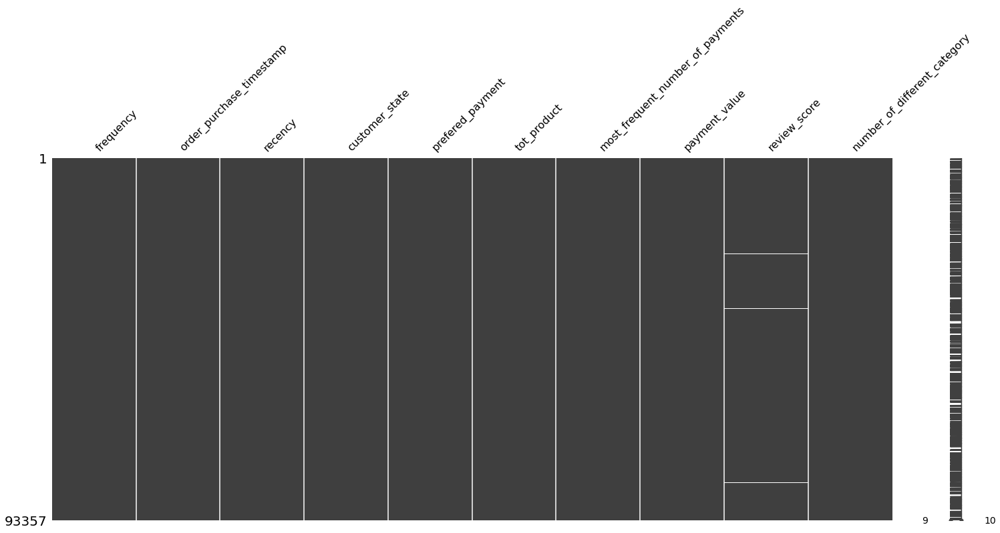

In [43]:
msno.matrix(work_df)

In [44]:
work_df.review_score = work_df.review_score.fillna(0)

In [45]:
work_df.dtypes

frequency                                    int64
order_purchase_timestamp            datetime64[ns]
recency                                    float64
customer_state                              object
prefered_payment                            object
tot_product                                  int64
most_frequent_number_of_payments           float64
payment_value                              float64
review_score                               float64
number_of_different_category                 int64
dtype: object

**Export du dataframe pour segmentation** 

In [46]:
df.seller_zip_code_prefix = df['seller_zip_code_prefix'].astype('object', copy=False)
df.customer_zip_code_prefix = df['customer_zip_code_prefix'].astype('object', copy = False)

In [47]:
work_df.to_csv('data_agg_cleaned.csv')
df.to_csv('data_cleaned.csv')

In [48]:
work_df

,frequency,order_purchase_timestamp,recency,customer_state,prefered_payment,tot_product,most_frequent_number_of_payments,payment_value,review_score,number_of_different_category
customer_unique_id,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,111.0,SP,credit_card,1,8.0,141.90,5.0,1
0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,114.0,SP,credit_card,1,1.0,27.19,4.0,1
0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,536.0,SC,credit_card,1,8.0,86.22,3.0,1
0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,320.0,PA,credit_card,1,4.0,43.62,4.0,1
0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,287.0,SP,credit_card,1,6.0,196.89,5.0,1
...,...,...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1,2017-06-08 21:00:36,446.0,PE,credit_card,4,10.0,4134.84,5.0,1
fffea47cd6d3cc0a88bd621562a9d061,1,2017-12-10 20:07:56,261.0,BA,credit_card,1,1.0,84.58,4.0,1
ffff371b4d645b6ecea244b27531430a,1,2017-02-07 15:49:16,567.0,MT,credit_card,1,1.0,112.46,5.0,1


In [49]:
work_df

,frequency,order_purchase_timestamp,recency,customer_state,prefered_payment,tot_product,most_frequent_number_of_payments,payment_value,review_score,number_of_different_category
customer_unique_id,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,2018-05-10 10:56:27,111.0,SP,credit_card,1,8.0,141.90,5.0,1
0000b849f77a49e4a4ce2b2a4ca5be3f,1,2018-05-07 11:11:27,114.0,SP,credit_card,1,1.0,27.19,4.0,1
0000f46a3911fa3c0805444483337064,1,2017-03-10 21:05:03,536.0,SC,credit_card,1,8.0,86.22,3.0,1
0000f6ccb0745a6a4b88665a16c9f078,1,2017-10-12 20:29:41,320.0,PA,credit_card,1,4.0,43.62,4.0,1
0004aac84e0df4da2b147fca70cf8255,1,2017-11-14 19:45:42,287.0,SP,credit_card,1,6.0,196.89,5.0,1
...,...,...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1,2017-06-08 21:00:36,446.0,PE,credit_card,4,10.0,4134.84,5.0,1
fffea47cd6d3cc0a88bd621562a9d061,1,2017-12-10 20:07:56,261.0,BA,credit_card,1,1.0,84.58,4.0,1
ffff371b4d645b6ecea244b27531430a,1,2017-02-07 15:49:16,567.0,MT,credit_card,1,1.0,112.46,5.0,1


## Analyse exploratoire  

In [50]:
work_df.describe().T

,count,mean,std,min,25%,50%,75%,max
frequency,93357.0,1.033420,0.209099,1.00,1.0,1.00,1.00,15.00
recency,93357.0,236.936673,152.584315,0.00,113.0,218.00,345.00,694.00
tot_product,93357.0,1.869672,14.322201,1.00,1.0,1.00,1.00,2790.00
most_frequent_number_of_payments,93357.0,2.938323,2.721441,0.00,1.0,2.00,4.00,24.00
payment_value,93357.0,180.866333,278.398996,10.07,64.0,111.55,192.39,15978.65
review_score,93357.0,4.126629,1.318943,0.00,4.0,5.00,5.00,5.00
number_of_different_category,93357.0,1.022280,0.156129,1.00,1.0,1.00,1.00,5.00


In [51]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, shared_yaxes=True,
                    subplot_titles=("Nombre de données par catégorie avant mapping",
                                    "Nombre de données par catégorie après mapping"))

fig.add_trace(go.Bar(x = products_en.product_category_name_english.value_counts().index,
                     y= products_en.product_category_name_english.value_counts().values),
                     1, 1)
fig.add_trace( go.Bar(x= products_en.product_category_name.value_counts().index,
                      y= products_en.product_category_name_english.value_counts().values),
                     1,2 )
fig.update_layout( width=1000,
                  height=700,
                  title_text = "Données par catégories",
                  showlegend = False)
              

fig.show()

### Etude de la Récence 

In [52]:
px.line(result.seasonal, x = result.seasonal.index, y = result.seasonal)

NameError: name 'result' is not defined

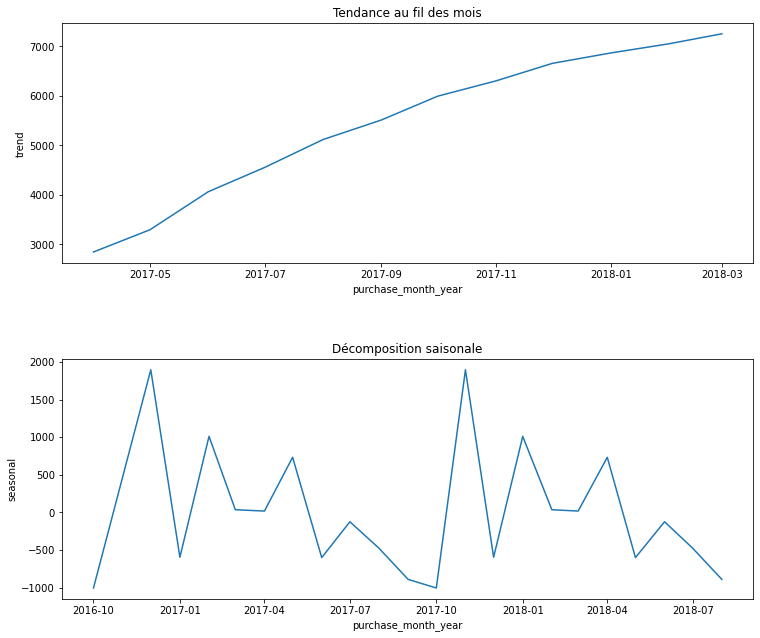

In [53]:
from statsmodels.tsa.seasonal import seasonal_decompose

df['purchase_month_year'] = df['order_purchase_timestamp'].dt.to_period('M')
period_decompose = df.groupby('purchase_month_year').size()
period_decompose.index = period_decompose.index.astype('datetime64[ns]')
period_decompose.sort_index(inplace = True)

result = seasonal_decompose(period_decompose, model='additive', period= 11)

#px.line(result.seasonal, x = result.seasonal.index, y = result.seasonal)
fig, ax = plt.subplots(2,1,figsize=(12,10))
#sns.lineplot(data=result.observed, x=result.observed.index, y=result.observed, ax=ax[0])
sns.lineplot(data=result.trend, x=result.trend.index, y=result.trend, ax=ax[0])
sns.lineplot(data=result.seasonal, x=result.seasonal.index, y=result.seasonal, ax=ax[1])
#sns.lineplot(data=result.resid, x=result.resid.index, y=result.resid, ax=ax[3])
plt.tight_layout()
ax[0].title.set_text('Tendance au fil des mois')
ax[1].title.set_text('Décomposition saisonale')
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.4, 
                    hspace=0.4)
plt.show()

* La tendance est à l'augmentation constante.
* On peut observer deux pics de commandes décembre 2016 et en novembre 2017. 
* On voit clairement que la période creuse est fin aout, septembre sur 2017 et 2018.

In [54]:
px.box(work_df.recency)

In [55]:
fig = px.histogram(work_df.recency,
             title = "Histogramme de la récence(jours)")
fig.update_layout(showlegend= False)

In [56]:
px.histogram(work_df[work_df.frequency > 1 ].recency,
             title = "Histogramme de la récence pour les clients multiple")

* Nous observons un pic de récence à 9 mois, ce qui qui correspond au mois de décembre de l'année 2017 vu la dernière date d'achat 
* La valeur médiane est de 7 mois environ. 
_______________

**Observons les commandes selon leur mois**


In [57]:
work_df["purchase_month"] = work_df.order_purchase_timestamp.apply(lambda x: x.month).map({1:'Jan',2:'Feb',3:'Mar',
                                                                                 4:'Apr',5:'May',6:'Jun',
                                                                                 7:'Jul',8:'Aug',9:'Sep',
                                                                                 10:'Oct',11:'Nov',12:'Dec'})

In [58]:
fig = px.bar(work_df.purchase_month.value_counts(),title = "Nombre d'achat suivant les mois")
fig.update_xaxes(title_text= 'Month')
fig.update_yaxes(title_text = 'Number of orders')
fig.update_layout(showlegend = False)
fig.show()


* Les commandes sont surtout passées en **août** et en **mai**. 
* Au contraire, la période la moins productive en terme de commandes est en fin d'années.  

### Etude de la fréquence d'achat des clients 

In [59]:
px.box(work_df.frequency)

In [60]:
work_df.frequency.value_counts(normalize=True)

1     0.969997
2     0.027561
3     0.001939
4     0.000300
5     0.000096
6     0.000054
7     0.000032
9     0.000011
15    0.000011
Name: frequency, dtype: float64

<AxesSubplot:xlabel='frequency', ylabel='Density'>

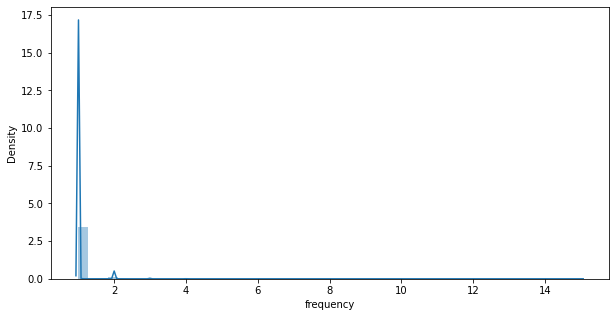

In [61]:
plt.figure(figsize=(10,5))
sns.distplot(work_df.frequency)

In [62]:
fig =px.bar(work_df.frequency.value_counts(normalize=True), 
           title = "Fréquence d'achat des clients")
fig.update_xaxes(title = "Fréquence")
fig.update_yaxes(title = "Pourcentages")

Il n'y a que 3% des clients qui ont fait plus d'une commande sur le site. 
Un client a fait 15 commandes sur le site. Valeur atypique mais pas abérrante 

### Quel est le montant par commandes?

<AxesSubplot:xlabel='payment_value', ylabel='Density'>

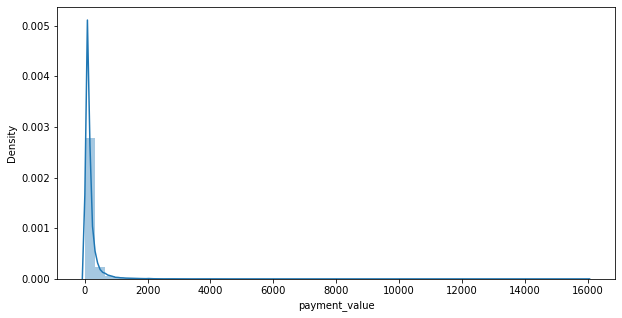

In [63]:
plt.figure(figsize=(10,5))
sns.distplot(work_df.payment_value)

In [64]:
quantile_pay = work_df.payment_value.quantile([0,0.25,0.5,0.75,1])
quantile_pay

0.00       10.07
0.25       64.00
0.50      111.55
0.75      192.39
1.00    15978.65
Name: payment_value, dtype: float64

In [65]:
fig = px.box(work_df,x = "payment_value", points = False,
      title = "Diagramme en boîte des montants dépensés")

#for x in zip(["min","q1","med","q3","max"],work_df.payment_value.quantile([0,0.25,0.5,0.75,1]).values):
fig.add_annotation(text="min" + ": " + str(quantile_pay.iloc[0]),
                  xref="paper", yref="paper",
                  x=0.1, y=0.4, showarrow=False)
fig.add_annotation(text="q1" + ": " + str(quantile_pay.iloc[1]),
                  xref="paper", yref="paper",
                  x=0.3, y=0.4, showarrow=False)
fig.add_annotation(text="med" + ":" + str(quantile_pay.iloc[2]),
                  xref="paper", yref="paper",
                  x=0.3, y=0.3, showarrow=False)
fig.add_annotation(text="q3" + ":" + str(quantile_pay.iloc[3]),
                  xref="paper", yref="paper",
                  x=0.3, y=0.2, showarrow=False)
fig.add_annotation(text="max" + ":" + str(quantile_pay.iloc[4]),
                  xref="paper", yref="paper",
                  x=0.1, y=0.3, showarrow=False)


fig.show()

* Le montant moyen, de commande est de 111,55 Reals. 
* La commande minimale fait 10 Reals, c'est peu mais pas un outlier.
* La commande la plus élévées fait 16 000 Reals, gros montant mais pas impossible

In [66]:
df.groupby(['customer_unique_id', 'order_id', 'product_category_name'])[['price']].sum().sort_values(ascending=False, by= 'price')

,,,price
customer_unique_id,order_id,product_category_name,
c4b224d2c784bae11ae98b6ae9f2454c,4bfcba9e084f46c8e3cb49b0fa6e6159,culture,21712.20
be74c431147c32ab2d7c7cef5e4a995f,f489949dbe23cf9313deb342913ece0c,electronics,19040.28
1033eef37a760a832f9b2332ce23fdc5,858d458b39082890e96fbb1fed8c2a52,electronics,15598.80
58483a1c055dfb600f57c5b867174542,9de73f3e6157169ad6c32b9f313c7dcb,fashion,15596.00
7a96eb0a685f5c19b7dad29fc802aa64,f398a143c0fe171d965db2096cf064cf,hygiene_and_beauty,12496.00
...,...,...,...
728e4a7d0db4845270091ded0923c71f,38bcb524e1c38c2c1b60600a80fc8999,garden_outdoors,2.90
bd06ce0e06ad77a7f681f1a4960a3cc6,e8bbc1d69fee39eee4c72cb5c969e39d,housewares,2.29
b38211bd797f4fdd81a98b9d1754b606,6e864b3f0ec71031117ad4cf46b7f2a1,tools,0.85


In [67]:
px.bar(df.groupby(['order_id'])[['price']].sum().sort_values(ascending=False, by= 'price').head(50),
      title = "Amount by order")

In [68]:
custom_cat = df.groupby(['customer_unique_id', 'product_category_name'])[['price']].max().sort_values(ascending=False,
                                                                                                      by= 'price')
custom_cat

,,price
customer_unique_id,product_category_name,
dc4802a71eae9be1dd28f5d788ceb526,housewares,6735.00
459bef486812aa25204be022145caa62,electronics,6729.00
ff4159b92c40ebe40454e3e6a7c35ed6,culture,6499.00
da122df9eeddfedc1dc1f5349a1a690c,appliances,4799.00
eebb5dda148d3893cdaf5b5ca3040ccb,appliances,4690.00
...,...,...
bd06ce0e06ad77a7f681f1a4960a3cc6,housewares,2.29
317cfc692e3f86c45c95697c61c853a6,hygiene_and_beauty,2.20
d80730c15c647bc8f2ad77c908ba5ca9,tools,0.85


In [69]:
custom_cat.droplevel("customer_unique_id")

,price
product_category_name,
housewares,6735.00
electronics,6729.00
culture,6499.00
appliances,4799.00
appliances,4690.00
...,...
housewares,2.29
hygiene_and_beauty,2.20
tools,0.85


In [70]:
px.bar(custom_cat.droplevel("customer_unique_id").head(100),
      title = "Amount paid per categories")

Les plus gros postes de dépenses sont sur **l'électronique** comme on pouvait le deviner. Les vêtements et articles de mode. Et les appareils électroménagés.

### Etude de la satisfaction client


In [71]:
px.box(work_df,x="review_score")

* La note moyenne laissée est **5**, elle représente 58% des clients.
* Il y a 600 notes **0**, presque 1% des clients. 


In [72]:
px.histogram(work_df.review_score, nbins=20, title = "Moyenne des scores donnés")

### Quel est le panier moyen par commandes? 

Combien d'articles sont achetés par commandes? 

In [73]:
px.box(work_df,x= "frequency")

In [74]:
px.histogram(work_df.frequency)

* La majorité des commandes comportent un seul article. 

### Quel est la catégorie la plus vendue?

In [75]:
category = df.sort_values([
    'customer_id','product_category_name']
    , ascending=False).groupby([
    'customer_id', 'product_category_name']).head(1)[[
        'customer_unique_id', 'product_category_name']]
category.columns = ['customer_unique_id', 'most_purchased_category']
category.set_index('customer_unique_id')

category.most_purchased_category.value_counts()

decoration            15671
auto_leisure          15137
electronics           14617
hygiene_and_beauty    11746
fashion               11659
housewares             8431
tools                  5336
other                  4950
culture                2147
furniture              2033
appliances             1914
garden_outdoors        1855
food_drinks            1126
service                 274
services                234
Name: most_purchased_category, dtype: int64

In [76]:
fig = px.bar(category.most_purchased_category.value_counts(), title = 'Nombre de produits vendus par catégories')
fig.update_xaxes(title_text= 'categories')
fig.update_layout(showlegend = False)
fig.show()

Les catégories les plus vendus sont: 
* les articles de décoration,
* de loisirs et pour la voiture et le matériel électronique. 

### Analyse des corrélations

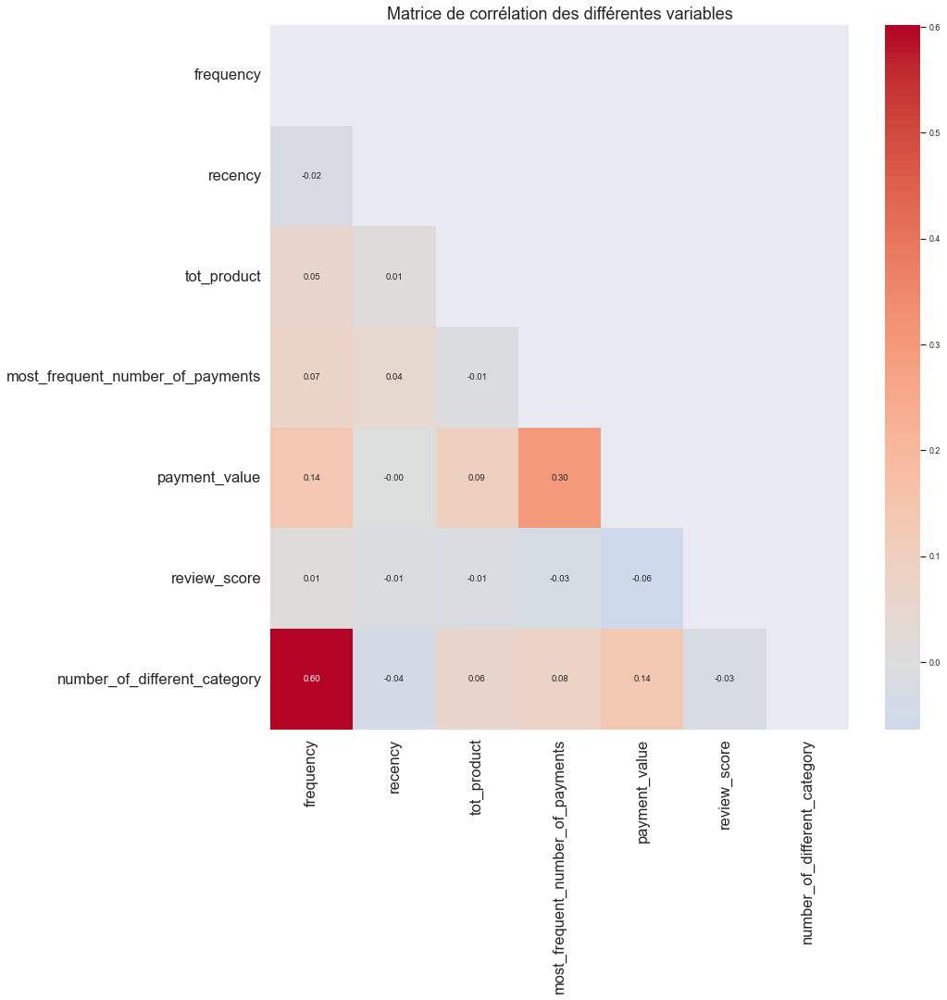

In [77]:
# Sélection des variables numériques du dataset
work_df = work_df.select_dtypes(include='number')

# Calcul et affichage matrice de corrélation
corr_matrix = work_df.corr()

masque = np.zeros_like(corr_matrix)
masque[np.triu_indices_from(masque)] = True

fig = plt.figure(1, figsize=(14,14))
sns.set(font_scale=1.5)
plt.title('Matrice de corrélation des différentes variables')
sns.set(font_scale=0.8)
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", mask=masque, fmt=".2f", center=0)
plt.show()


# Fin du nettoyage et de l'analyse exploratoire. 

Suite avec le notebook 2 d'essais de segmentation.